In [8]:
import os

MNT = os.getenv("MOUNT_PATH")
print(MNT)

PROJECT="NBS_ADAPTS"
KEY="DOM_merged_test"
data_type="damages_scaled"



/app/data


## Damages
The code below generates damages for the following scenarios:
- Future Climate
- Future Climate + Mangroves
- Future Climate + Reefs
- Future Climate + Mangroves and Reefs

In [11]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

import matplotlib.ticker as ticker
import matplotlib.patheffects as PathEffects



def format_ticks(value, pos, prefix="$"):
    if value >= 1e9:
        return f'{prefix}{value*1e-9:.1f}B'
    elif value >= 1e6:
        return f'{prefix}{value*1e-6:.1f}M'
    elif value >= 1e3:
        return f'{prefix}{value*1e-3:.1f}K'
    else:
        return f'{prefix}{value:.0f}'


def plot_parquet_file(gdf, column, colorbar, title, subtitle, column_to_use_for_max=None, description=None, subdescription=None, threshold = 1e6, prefix="$"):
    # Load the .parquet file into a GeoDataFrame
    fig, ax = plt.subplots(figsize=(12, 8), dpi=300)
    
    # Set transparency for values below a certain threshold
    gdf['alpha'] = gdf[column].apply(lambda x: 0.2 if x < threshold else 1)
    
    if column_to_use_for_max:
        max_value = gdf[column_to_use_for_max].max()
    else:
        max_value = gdf[column].max()
    ax = gdf.plot(ax=ax, column=column, cmap=colorbar, alpha=gdf['alpha'], legend=True, vmin=threshold, vmax=max_value) 
    # Plot the specified column of the GeoDataFrame with the colorbar
    # ax = gdf.plot(ax=ax, column=column, cmap=colorbar, legend=True)
    
    bbox = ax.get_position()
    cax = fig.axes[1]  # Get the colorbar axis
    cax.set_position([bbox.x1 + 0.01, bbox.y0, 0.03, bbox.height])  # [left, bottom, width, height]
    
    # Remove the border around the map
    ax.set_frame_on(False)
    
    # Remove the ticks from around the map
    ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
    
    # Format the legend ticks to "$"
    cax.yaxis.set_major_formatter(ticker.FuncFormatter(format_ticks))
    
    # Add title and subtitle to the graph
    ax.set_title(title, fontsize=16, loc='left', pad=20)
    ax.text(0, 1.01, subtitle, transform=ax.transAxes, fontsize=12, verticalalignment='bottom', horizontalalignment='left')
    
    
    if description:
        ax.text(.99, 0.05, description, transform=ax.transAxes, fontsize=8, verticalalignment='bottom', horizontalalignment='right', color='white')
    if subdescription:
        ax.text(.99, 0.01, subdescription.format(threshold=format_ticks(threshold, None)), transform=ax.transAxes, fontsize=6, verticalalignment='bottom', horizontalalignment='right', color='white')
    
    # Find the two regions with the highest values
    top_two = gdf.nlargest(2, column)
    for idx, row in top_two.iterrows():
        ax.scatter(row.geometry.centroid.x, row.geometry.centroid.y, color='white', s=11)
        ax.scatter(row.geometry.centroid.x, row.geometry.centroid.y, color='black', s=7)
    for idx, row in top_two.iterrows():
        ax.annotate(
            format_ticks(row[column], None), 
            xy=(row.geometry.centroid.x, row.geometry.centroid.y), 
            xytext=(3,3), 
            textcoords="offset points", 
            color='black', 
            fontsize=8,
            path_effects=[PathEffects.withStroke(linewidth=1, foreground='white')]
        )
        
    
    ctx.add_basemap(ax, crs=gdf.crs.to_string(), source=ctx.providers.Esri.WorldImagery, attribution_size=3, zoom=10)
    
    ctx.add_attribution(ax, text="", font_size=8)
    
    

basedir = os.path.join(MNT, PROJECT, KEY, data_type, "summary_stats")
figpath = os.path.join(basedir, "figures")
if not os.path.exists(figpath):
    os.makedirs(figpath)

f = os.path.join(basedir, f"dom_subunits_{data_type}.parquet")
gdf = gpd.read_parquet(f)

Climate = "Historic"
Title = "Damages, Current Climate"

for s in ("S2", "S3", "S4"):
    gdf[f"AEV-Econ_{Climate}_{s}-S1_sum"] = gdf[f"AEV-Econ_{Climate}_{s}_sum"] - gdf[f"AEV-Econ_{Climate}_S1_sum"]   

for idx, (column, title, subtitle) in enumerate([
    (f"AEV-Econ_{Climate}_S1_sum", Title, "Existing Ecosystems"),
    (f"AEV-Econ_{Climate}_S2_sum", Title, "Mangrove Degradation"),
    (f"AEV-Econ_{Climate}_S3_sum", Title, "Reef Degradation"),
    (f"AEV-Econ_{Climate}_S4_sum", Title, "Mangrove and Reef Degradation"),
    (f"AEV-Econ_{Climate}_S2-S1_sum", Title, "Benefits of Mangroves"),
    (f"AEV-Econ_{Climate}_S3-S1_sum", Title, "Benefits of Reefs"),
    (f"AEV-Econ_{Climate}_S4-S1_sum", Title, "Combined Benefits of Reefs and Mangroves"),
]):
    if idx < 4:
        column_to_use_for_max = f"AEV-Econ_{Climate}_S4_sum"
        colorbar = "YlOrRd"
        threshold = 1e6
    else:
        column_to_use_for_max = f"AEV-Econ_{Climate}_S4-S1_sum"
        colorbar = "Blues"
        threshold = 1e5
    plot_parquet_file(
        gdf, 
        column=column, 
        colorbar=colorbar, 
        title=title,
        subtitle=subtitle,
        subdescription="Showing values > {threshold}",  
        threshold=threshold,
        column_to_use_for_max=column_to_use_for_max
    )   
    plt.savefig(os.path.join(figpath, f"{column}.png"))
    plt.show()


KeyError: 'AEV-Econ_Future2050_S2_sum'

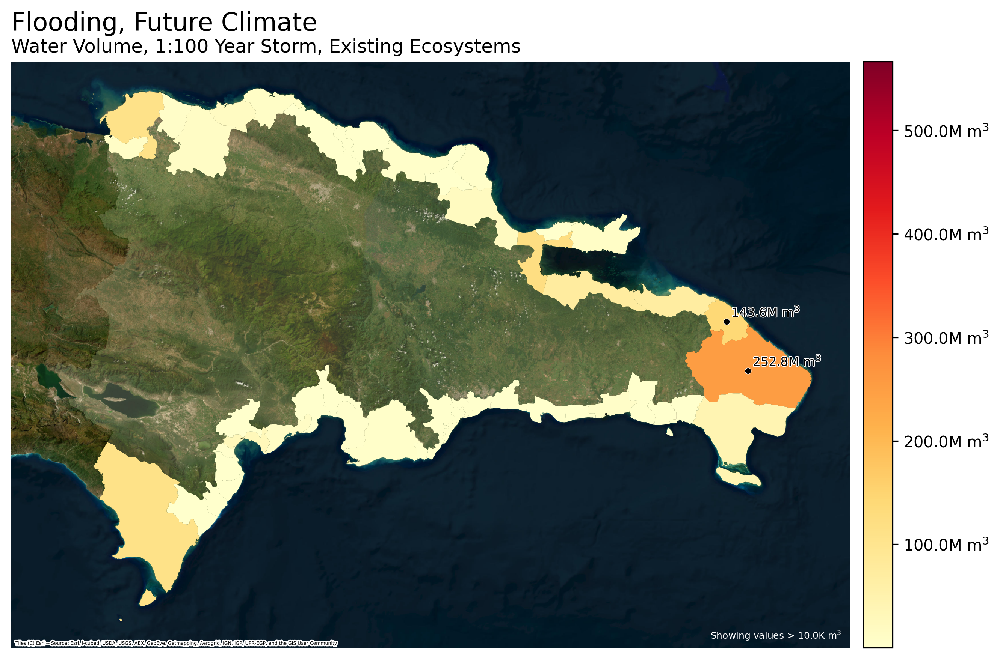

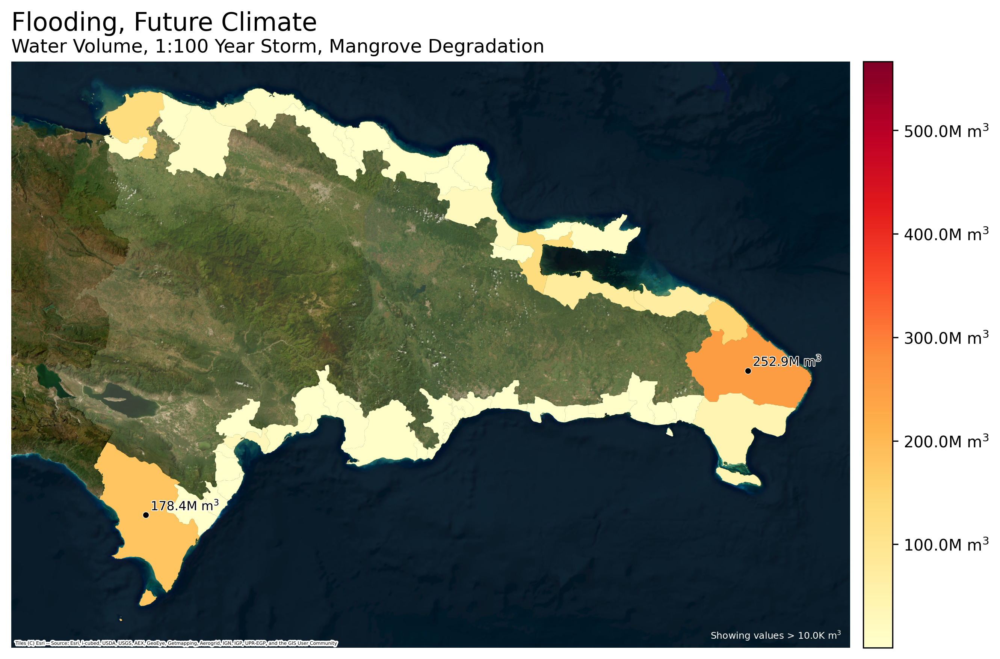

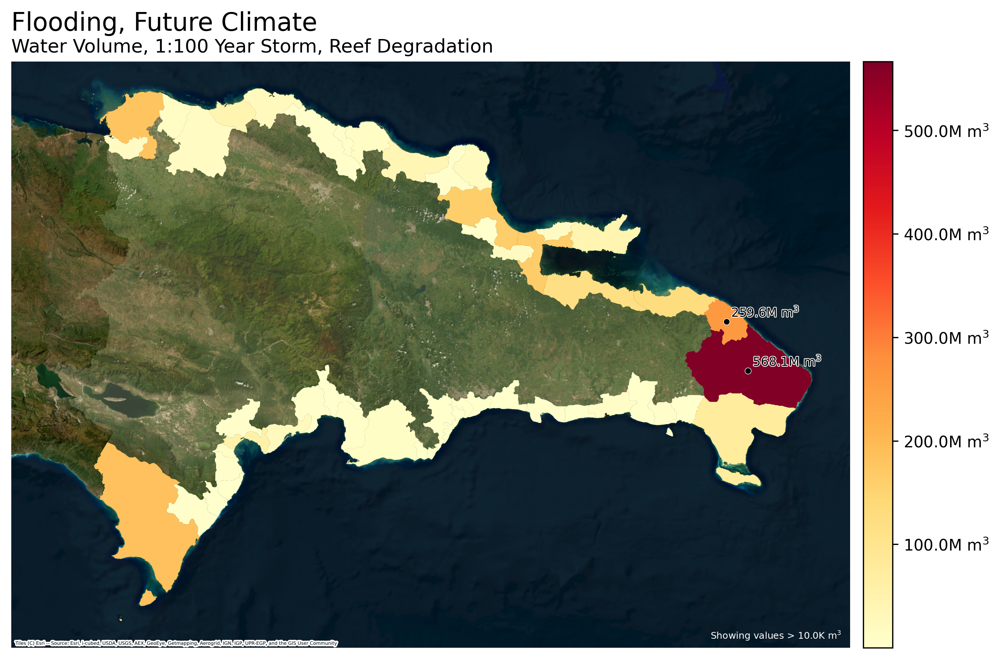

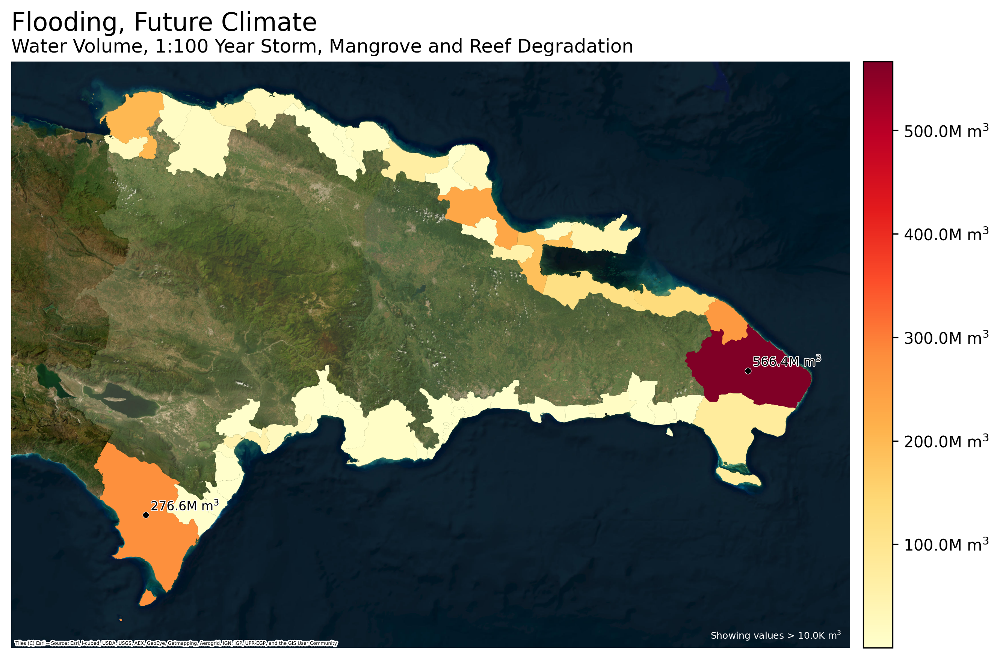

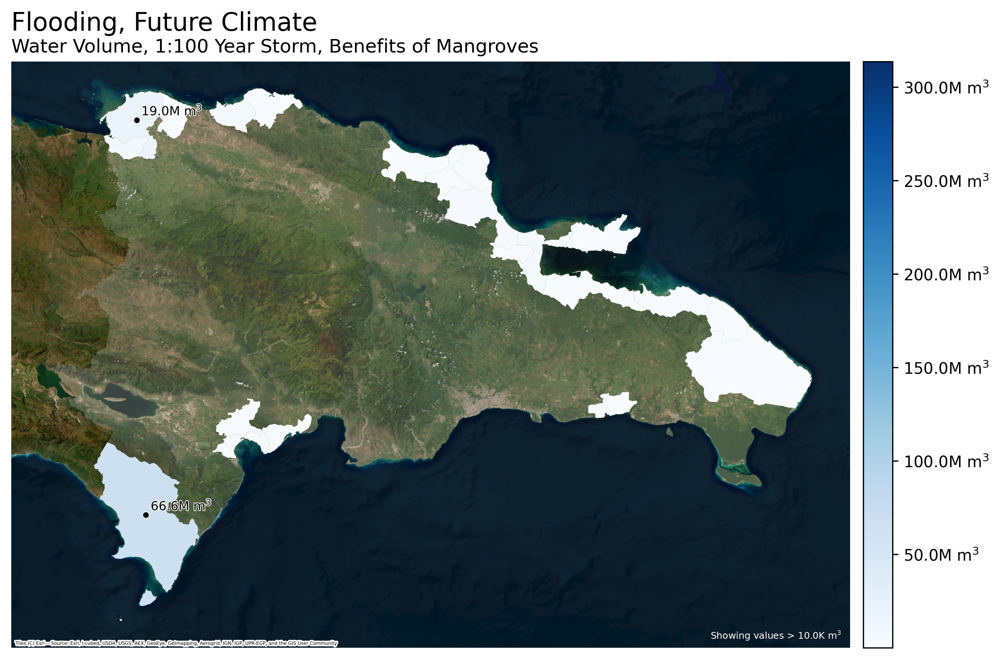

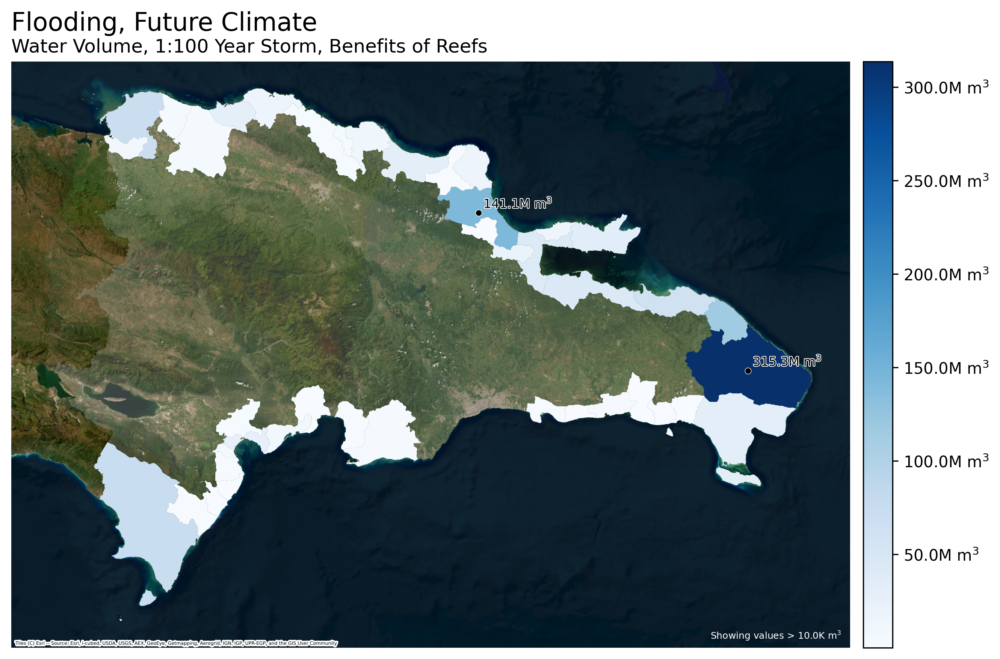

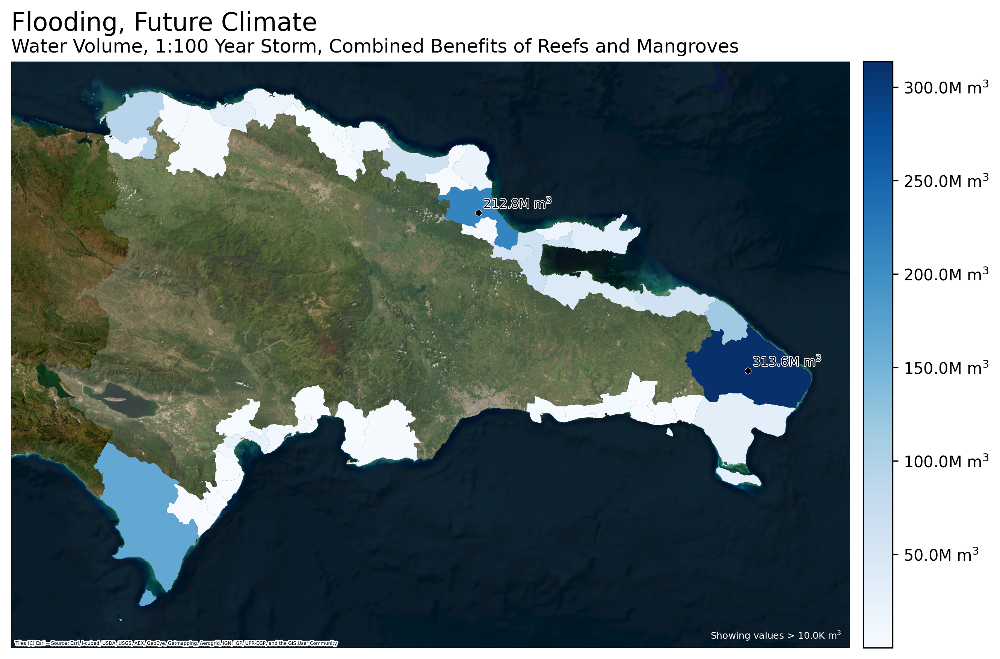

In [10]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

import matplotlib.ticker as ticker
import matplotlib.patheffects as PathEffects

import copy




def format_ticks(value, pos, suffix=f"m$^{{{'3'}}}$"):
    if value >= 1e9:
        return f'{value*1e-9:.1f}B {suffix}'
    elif value >= 1e6:
        return f'{value*1e-6:.1f}M {suffix}'
    elif value >= 1e3:
        return f'{value*1e-3:.1f}K {suffix}'
    else:
        return f'{value:.0f} {suffix}'


def plot_parquet_file(gdf, column, colorbar, title, subtitle, column_to_use_for_max=None, description=None, subdescription=None, threshold = 1e6, prefix="$"):
    # Load the .parquet file into a GeoDataFrame
    fig, ax = plt.subplots(figsize=(12, 8), dpi=300)
    gdf = copy.deepcopy(gdf)
    
    # Rescale to get volume
    gdf[column] = gdf[column] * 30 * 30
    
    # Get the max value
    if column_to_use_for_max and column_to_use_for_max != column:
        max_value = (gdf[column_to_use_for_max] * 30 * 30).max()
    else:
        max_value = gdf[column].max()
        
    # Set transparency for values below a certain threshold
    gdf['alpha'] = gdf[column].apply(lambda x: 0.2 if x < threshold else 1)
    
    # Plot the specified column of the GeoDataFrame with the colorbar
    ax = gdf.plot(ax=ax, column=column, cmap=colorbar, alpha=gdf['alpha'], legend=True, vmin=threshold, vmax=max_value) 
    
    # Reposition the Legend
    bbox = ax.get_position()
    cax = fig.axes[1]  # Get the colorbar axis
    cax.set_position([bbox.x1 + 0.01, bbox.y0, 0.03, bbox.height])  # [left, bottom, width, height]
    
    # Remove the border around the map
    ax.set_frame_on(False)
    
    # Remove the ticks from around the map
    ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
    
    # Format the legend ticks to "$"
    cax.yaxis.set_major_formatter(ticker.FuncFormatter(format_ticks))
    
    # Add title and subtitle to the graph
    ax.set_title(title, fontsize=16, loc='left', pad=20)
    ax.text(0, 1.01, subtitle, transform=ax.transAxes, fontsize=12, verticalalignment='bottom', horizontalalignment='left')
    
    # Add Description
    if description:
        ax.text(.99, 0.05, description, transform=ax.transAxes, fontsize=8, verticalalignment='bottom', horizontalalignment='right', color='white')
    if subdescription:
        ax.text(.99, 0.01, subdescription.format(threshold=format_ticks(threshold, None)), transform=ax.transAxes, fontsize=6, verticalalignment='bottom', horizontalalignment='right', color='white')
    
    # Find the two regions with the highest values and plot them
    top_two = gdf.nlargest(2, column)
    for idx, row in top_two.iterrows():
        ax.scatter(row.geometry.centroid.x, row.geometry.centroid.y, color='white', s=11)
        ax.scatter(row.geometry.centroid.x, row.geometry.centroid.y, color='black', s=7)
    for idx, row in top_two.iterrows():
        ax.annotate(
            format_ticks(row[column], None), 
            xy=(row.geometry.centroid.x, row.geometry.centroid.y), 
            xytext=(3,3), 
            textcoords="offset points", 
            color='black', 
            fontsize=8,
            path_effects=[PathEffects.withStroke(linewidth=1, foreground='white')]
        )
        
    # Add a basemap
    ctx.add_basemap(ax, crs=gdf.crs.to_string(), source=ctx.providers.Esri.WorldImagery, attribution_size=3, zoom=10)
    
    
    
data_type = "flooding"
rp = "Tr100"
basedir = os.path.join(MNT, PROJECT, KEY, data_type, "summary_stats")
figpath = os.path.join(basedir, "figures")
if not os.path.exists(figpath):
    os.makedirs(figpath)

f = os.path.join(basedir, f"dom_subunits_{data_type}.parquet")
gdf = gpd.read_parquet(f)

Climate = "Future2050"
Title = "Flooding, Future Climate"

for s in ("S2", "S3", "S4"):
    gdf[f"WaterDepth_{Climate}_{s}-S1_{rp}_t33_sum"] = gdf[f"WaterDepth_{Climate}_{s}_{rp}_t33_sum"] - gdf[f"WaterDepth_{Climate}_S1_{rp}_t33_sum"]   

for idx, (column, title, subtitle) in enumerate([
    (f"WaterDepth_{Climate}_S1_{rp}_t33_sum", Title, "Water Volume, 1:100 Year Storm, Existing Ecosystems"),
    (f"WaterDepth_{Climate}_S2_{rp}_t33_sum", Title, "Water Volume, 1:100 Year Storm, Mangrove Degradation"),
    (f"WaterDepth_{Climate}_S3_{rp}_t33_sum", Title, "Water Volume, 1:100 Year Storm, Reef Degradation"),
    (f"WaterDepth_{Climate}_S4_{rp}_t33_sum", Title, "Water Volume, 1:100 Year Storm, Mangrove and Reef Degradation"),
    (f"WaterDepth_{Climate}_S2-S1_{rp}_t33_sum", Title, "Water Volume, 1:100 Year Storm, Benefits of Mangroves"),
    (f"WaterDepth_{Climate}_S3-S1_{rp}_t33_sum", Title, "Water Volume, 1:100 Year Storm, Benefits of Reefs"),
    (f"WaterDepth_{Climate}_S4-S1_{rp}_t33_sum", Title, "Water Volume, 1:100 Year Storm, Combined Benefits of Reefs and Mangroves"),
]):
    if idx < 4:
        column_to_use_for_max = f"WaterDepth_{Climate}_S4_{rp}_t33_sum"
        colorbar = "YlOrRd"
        threshold = 10000
    else:
        column_to_use_for_max = f"WaterDepth_{Climate}_S4-S1_{rp}_t33_sum"
        colorbar = "Blues"
        threshold = 10000
    plot_parquet_file(
        gdf, 
        column=column, 
        colorbar=colorbar, 
        title=title,
        subtitle=subtitle,
        subdescription="Showing values > {threshold}",  
        threshold=threshold,
        column_to_use_for_max=column_to_use_for_max
    )   
    plt.savefig(os.path.join(figpath, f"{column}.png"))
    plt.show()


In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

import matplotlib.ticker as ticker
import matplotlib.patheffects as PathEffects

import copy




def format_ticks(value, pos, suffix="people"):
    if value >= 1e9:
        return f'{value*1e-9:.1f}B {suffix}'
    elif value >= 1e6:
        return f'{value*1e-6:.1f}M {suffix}'
    elif value >= 1e3:
        return f'{value*1e-3:.1f}K {suffix}'
    else:
        return f'{value:.0f} {suffix}'


def plot_parquet_file(gdf, column, colorbar, title, subtitle, column_to_use_for_max=None, description=None, subdescription=None, threshold = 1e6, prefix="$"):
    # Load the .parquet file into a GeoDataFrame
    fig, ax = plt.subplots(figsize=(12, 8), dpi=300)
    gdf = copy.deepcopy(gdf)
    
    # Rescale to get volume
    gdf[column] = gdf[column]
    
    # Get the max value
    if column_to_use_for_max and column_to_use_for_max != column:
        max_value = (gdf[column_to_use_for_max]).max()
    else:
        max_value = gdf[column].max()
        
    # Set transparency for values below a certain threshold
    gdf['alpha'] = gdf[column].apply(lambda x: 0.2 if x < threshold else 1)
    
    # Plot the specified column of the GeoDataFrame with the colorbar
    ax = gdf.plot(ax=ax, column=column, cmap=colorbar, alpha=gdf['alpha'], legend=True, vmin=threshold, vmax=max_value) 
    
    # Reposition the Legend
    bbox = ax.get_position()
    cax = fig.axes[1]  # Get the colorbar axis
    cax.set_position([bbox.x1 + 0.01, bbox.y0, 0.03, bbox.height])  # [left, bottom, width, height]
    
    # Remove the border around the map
    ax.set_frame_on(False)
    
    # Remove the ticks from around the map
    ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)
    
    # Format the legend ticks to "$"
    cax.yaxis.set_major_formatter(ticker.FuncFormatter(format_ticks))
    
    # Add title and subtitle to the graph
    ax.set_title(title, fontsize=16, loc='left', pad=20)
    ax.text(0, 1.01, subtitle, transform=ax.transAxes, fontsize=12, verticalalignment='bottom', horizontalalignment='left')
    
    # Add Description
    if description:
        ax.text(.99, 0.05, description, transform=ax.transAxes, fontsize=8, verticalalignment='bottom', horizontalalignment='right', color='white')
    if subdescription:
        ax.text(.99, 0.01, subdescription.format(threshold=format_ticks(threshold, None)), transform=ax.transAxes, fontsize=6, verticalalignment='bottom', horizontalalignment='right', color='white')
    
    # Find the two regions with the highest values and plot them
    top_two = gdf.nlargest(2, column)
    for idx, row in top_two.iterrows():
        ax.scatter(row.geometry.centroid.x, row.geometry.centroid.y, color='white', s=11)
        ax.scatter(row.geometry.centroid.x, row.geometry.centroid.y, color='black', s=7)
    for idx, row in top_two.iterrows():
        ax.annotate(
            format_ticks(row[column], None), 
            xy=(row.geometry.centroid.x, row.geometry.centroid.y), 
            xytext=(3,3), 
            textcoords="offset points", 
            color='black', 
            fontsize=8,
            path_effects=[PathEffects.withStroke(linewidth=1, foreground='white')]
        )
        
    # Add a basemap
    ctx.add_basemap(ax, crs=gdf.crs.to_string(), source=ctx.providers.Esri.WorldImagery, attribution_size=3, zoom=10)
    
    
    
data_type = "population"
rp = "Tr100"
basedir = os.path.join(MNT, PROJECT, KEY, data_type, "summary_stats")
figpath = os.path.join(basedir, "figures_population")
if not os.path.exists(figpath):
    os.makedirs(figpath)

f = os.path.join(basedir, f"dom_subunits_{data_type}.parquet")
gdf = gpd.read_parquet(f)

for s in ("S2", "S3", "S4"):
    gdf[f"AEV-Pop_Future2050_{s}-S1_sum"] = gdf[f"AEV-Pop_Future2050_{s}_sum"] - gdf[f"AEV-Pop_Future2050_S1_sum"]   

for idx, (column, title, subtitle) in enumerate([
    (f"AEV-Pop_Future2050_S1_sum", "Population, Future Climate", "Annual Expected Population Exposed, Existing Ecosystems"),
    (f"AEV-Pop_Future2050_S2_sum", "Population, Future Climate", "Annual Expected Population Exposed, Mangrove Degradation"),
    (f"AEV-Pop_Future2050_S3_sum", "Population, Future Climate", "Annual Expected Population Exposed, Reef Degradation"),
    (f"AEV-Pop_Future2050_S4_sum", "Population, Future Climate", "Annual Expected Population Exposed, Mangrove and Reef Degradation"),
    (f"AEV-Pop_Future2050_S2-S1_sum", "Population Benefit, Future Climate", "Annual Expected Population Risk Reduction, Benefits of Mangroves"),
    (f"AEV-Pop_Future2050_S3-S1_sum", "Population Benefit, Future Climate", "Annual Expected Population Risk Reduction, Benefits of Reefs"),
    (f"AEV-Pop_Future2050_S4-S1_sum", "Population Benefit, Future Climate", "Annual Expected Population Risk Reduction, Combined Benefits of Reefs and Mangroves"),
]):
    if idx < 4:
        column_to_use_for_max = f"AEV-Pop_Future2050_S4_sum"
        colorbar = "YlOrRd"
        threshold = 20
    else:
        column_to_use_for_max = f"AEV-Pop_Future2050_S4-S1_sum"
        colorbar = "Blues"
        threshold = 20
    plot_parquet_file(
        gdf, 
        column=column, 
        colorbar=colorbar, 
        title=title,
        subtitle=subtitle,
        subdescription="Showing values > {threshold}",  
        threshold=threshold,
        column_to_use_for_max=column_to_use_for_max
    )   
    plt.savefig(os.path.join(figpath, f"{column}.png"))
    plt.show()


In [7]:
import geopandas as gpd

for data_type in ('flooding', 'damages_scaled', 'population'):
    print(i)
    basedir = os.path.join(MNT, PROJECT, KEY, data_type, "summary_stats")   
    print(basedir)
    
    f = os.path.join(basedir, f"dom_subunits_{data_type}.parquet")
    gdf = gpd.read_parquet(f)
    gdf = gdf.drop(columns=["geometry"])
    if data_type == "flooding":
        cols = [c for c in gdf.columns if "WaterDepth" in c]
        gdf[cols] = gdf[cols] * 30 * 30
        data_type = "flood_volume"
        print(gdf)
        gdf.to_csv(os.path.join(basedir, f"dom_subunits_{data_type}.csv"))
    
    gdf.to_csv(os.path.join(basedir, f"dom_subunits_{data_type}.csv"))

population
/app/data/NBS_ADAPTS/DOM_merged_test/flooding/summary_stats
       UID GID_0              NAME_0 VARNAME_0     GID_1         NAME_1  \
0    47887   DOM  Dominican Republic             DOM.1_1           Azua   
1    47888   DOM  Dominican Republic             DOM.1_1           Azua   
2    47889   DOM  Dominican Republic             DOM.1_1           Azua   
3    47890   DOM  Dominican Republic             DOM.1_1           Azua   
4    47891   DOM  Dominican Republic             DOM.1_1           Azua   
..     ...   ...                 ...       ...       ...            ...   
150  48037   DOM  Dominican Republic            DOM.31_1  Santo Domingo   
151  48038   DOM  Dominican Republic            DOM.31_1  Santo Domingo   
152  48039   DOM  Dominican Republic            DOM.32_1       Valverde   
153  48040   DOM  Dominican Republic            DOM.32_1       Valverde   
154  48041   DOM  Dominican Republic            DOM.32_1       Valverde   

    VARNAME_1 NL_NAME_1  ISO